Experimental Dataset - 2D class - class 93 - 128x128

# Setup

In [6]:
%matplotlib inline
import os, sys, glob, shutil
from matplotlib import pyplot as plt
import numpy as np
import torch
import h5py
from sklearn import metrics
sys.path.append('../utils/')
import functions_for_fred as fn
import nn
import viz
import pred

In [7]:
print('we are here {}'.format(os.getcwd()))

we are here /gpfs/slac/cryo/fs1/g/ML/vaegan/analysis


In [8]:
KEYWORD      = 'cryo_exp_class_2d_93_128x128'
CHECKPT_FILE = 'cryo_exp_class_2d_93_epoch_255_checkpoint.pth'
EPOCH_NUMBER = 255

In [9]:
DATASET_DIR     = '../train_val_datasets/'
METADATASET_DIR = '../datasets/exp/20181005-rib-TEM4/Sort/'
TRAINED_DIR = '../train_vae/'
TRAIN_DATASET_PATH     = DATASET_DIR+KEYWORD+'.npy'
TRAIN_METADATASET_PATH = METADATASET_DIR+'class2D_93_sort.h5'
TRAINED_CHECKPOINT     = 'epoch_'+str(EPOCH_NUMBER)+'_checkpoint.pth'
if not os.path.exists(KEYWORD):
    os.makedirs(KEYWORD)
if not os.path.exists(KEYWORD+'/train_vae'):
    os.makedirs(KEYWORD+'/train_vae')
if not os.path.isfile(KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT):
    shutil.copyfile(TRAINED_DIR+CHECKPT_FILE, KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT)

# Load dataset, encoder and decoder

In [10]:
dataset = np.load(TRAIN_DATASET_PATH)
metadata = h5py.File(TRAIN_METADATASET_PATH, 'r')
print('dataset.shape {} metadata.shape {}'.format(dataset.shape, metadata['particles'].shape))

dataset.shape (8278, 1, 128, 128) metadata.shape (8278, 180, 180)


In [11]:
mus = []
mus = fn.latent_projection(KEYWORD, TRAIN_DATASET_PATH, epoch_id=EPOCH_NUMBER)
mus.shape

cryo_exp_class_2d_93_128x128/train_vae/epoch_255_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_93_128x128/train_vae/epoch_255_checkpoint.pth.
Loading encoder from network of architecture: conv_orig...


(8278, 4)

In [12]:
recon = []
recon = fn.reconstruction(KEYWORD, torch.Tensor(mus[0:500,...]).cuda(), epoch_id=EPOCH_NUMBER)
recon.shape

cryo_exp_class_2d_93_128x128/train_vae/epoch_255_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_93_128x128/train_vae/epoch_255_checkpoint.pth.
Loading decoder from network of architecture: conv_orig...


(500, 1, 128, 128)

In [13]:
list(metadata.keys())

['_rlnamplitudecontrast',
 '_rlnanglepsi',
 '_rlnanglerot',
 '_rlnangletilt',
 '_rlnautopickfigureofmerit',
 '_rlnclassnumber',
 '_rlncoordinatex',
 '_rlncoordinatey',
 '_rlnctfbfactor',
 '_rlnctffigureofmerit',
 '_rlnctfmaxresolution',
 '_rlnctfscalefactor',
 '_rlndefocusangle',
 '_rlndefocusu',
 '_rlndefocusv',
 '_rlndetectorpixelsize',
 '_rlngroupnumber',
 '_rlnimagename',
 '_rlnloglikelicontribution',
 '_rlnmagnification',
 '_rlnmaxvalueprobdistribution',
 '_rlnmicrographname',
 '_rlnnormcorrection',
 '_rlnnrofsignificantsamples',
 '_rlnoriginx',
 '_rlnoriginy',
 '_rlnparticleselectzscore',
 '_rlnphaseshift',
 '_rlnsphericalaberration',
 '_rlnvoltage',
 'particles']

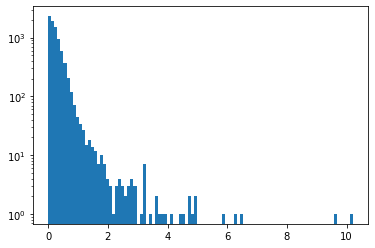

0.27756370142773734 0.3849067218255373


In [14]:
Zscore = np.array(metadata['_rlnparticleselectzscore'])
plt.hist(Zscore, bins=100, log=True)
plt.show()
print(np.mean(Zscore), np.std(Zscore))

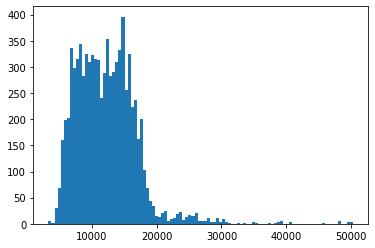

3333.739502 12189.916031496014 4691.042857648766


In [15]:
defocus = np.array(metadata['_rlndefocusu'])
plt.hist(defocus, bins=100, log=False)
plt.show()
print(np.min(defocus),np.mean(defocus), np.std(defocus))

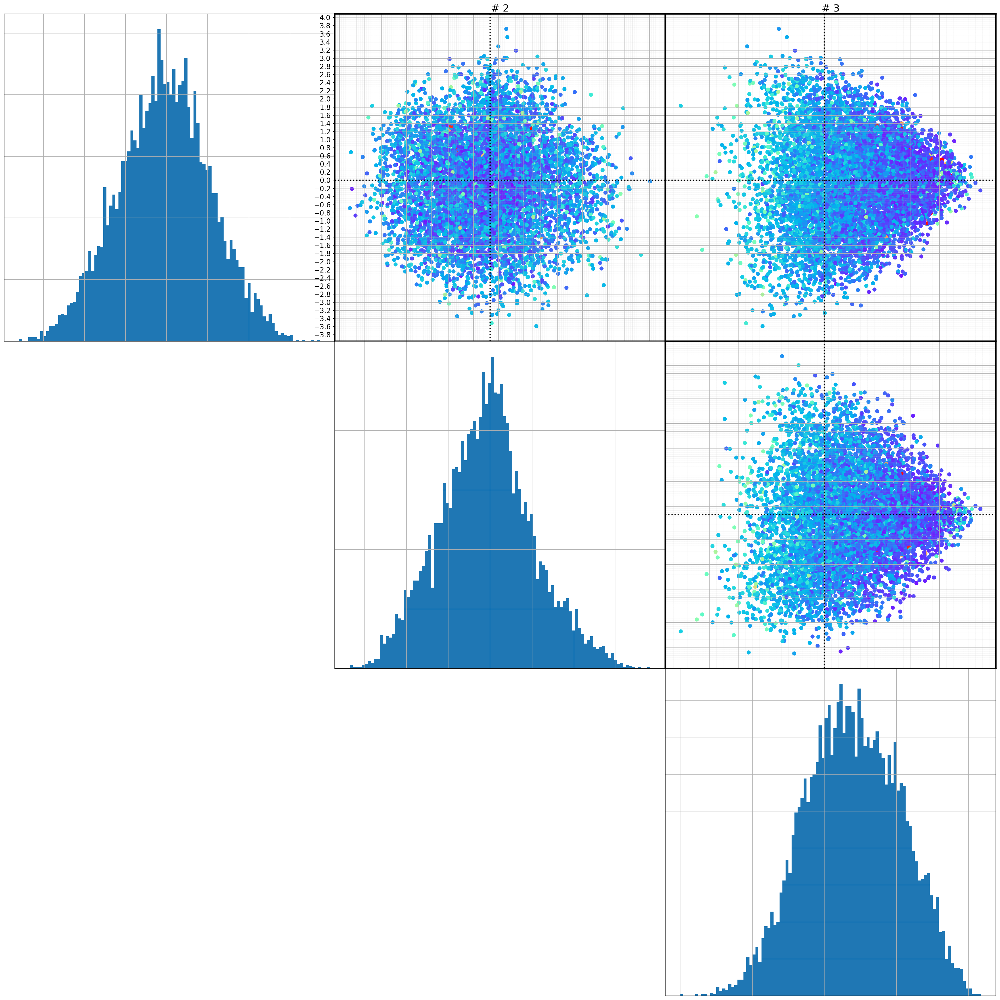

In [16]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_defocus_true')

In [17]:
center = np.mean(mus,axis=0) #np.zeros(mus.shape) #
U, L, Vt = np.linalg.svd(mus - center, full_matrices=False)

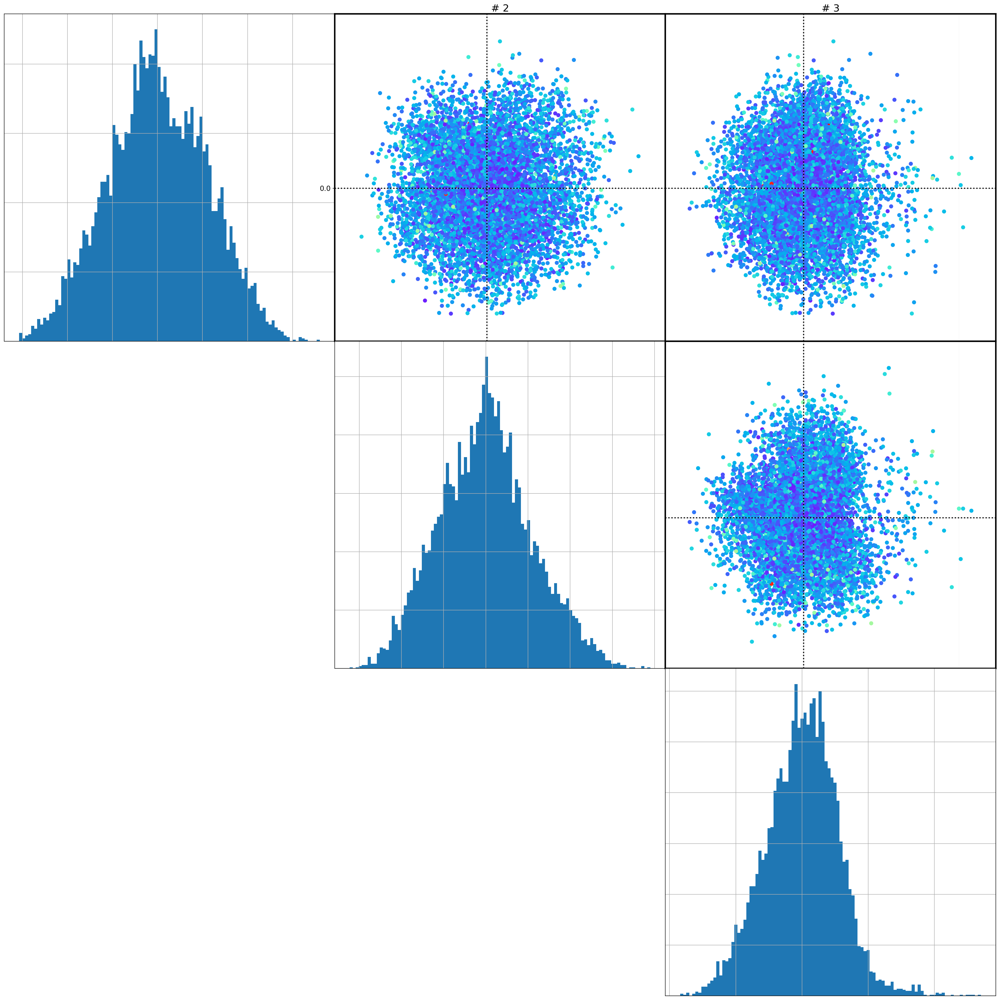

In [18]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_pca_defocus_true')

In [19]:
Zscore_set=2

In [20]:
positives = np.where(Zscore<Zscore_set)[0]
negatives = np.where(Zscore>Zscore_set)[0]
print(positives.shape,negatives.shape)

(8222,) (56,)


AUC(robust_covar) = 0.7920604997046253
AUC(isolation_forest) = 0.782198022726483
AUC(local_outlier_detection) = 0.7507840462869654


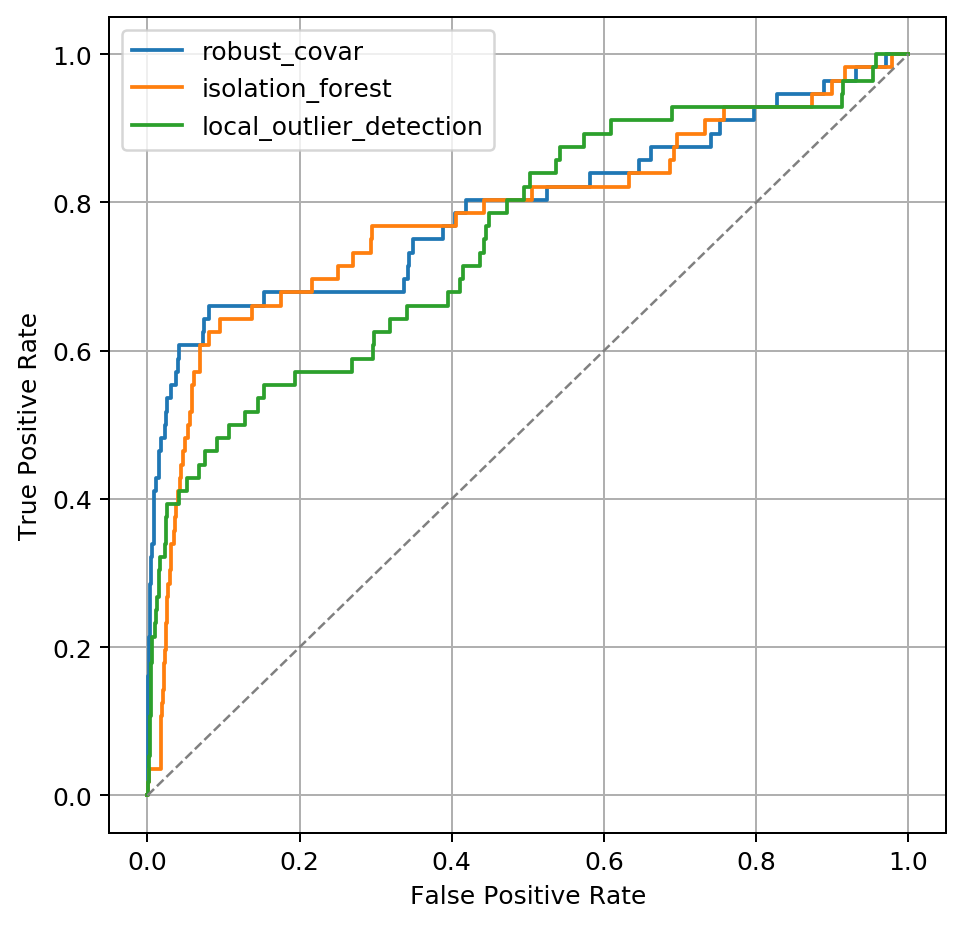

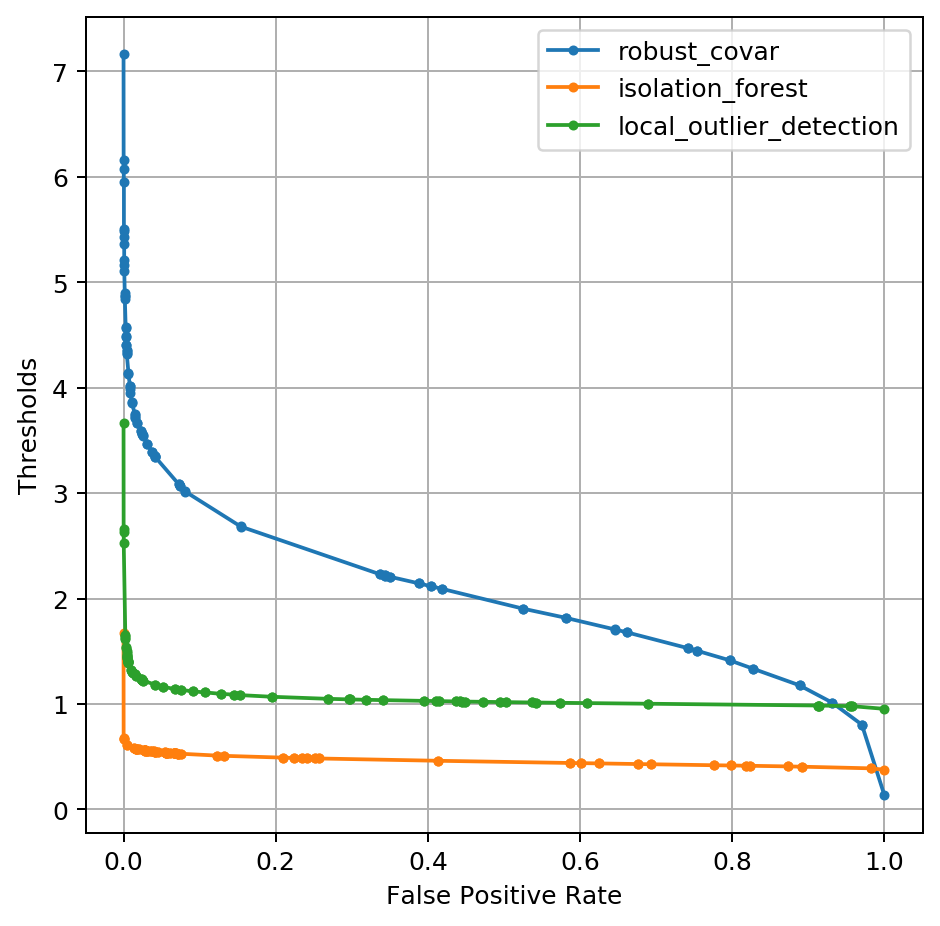

In [21]:
methods = ['robust_covar', 'isolation_forest', 'local_outlier_detection']
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,tpr)
    print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_Zscore'+str(Zscore_set))
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('Thresholds')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,thresholds, '.-')
    #print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
#plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_thresholds'+str(Zscore_set))

In [22]:
measure, offset, assignment = pred.outlier_measure(mus, method='robust_covar')

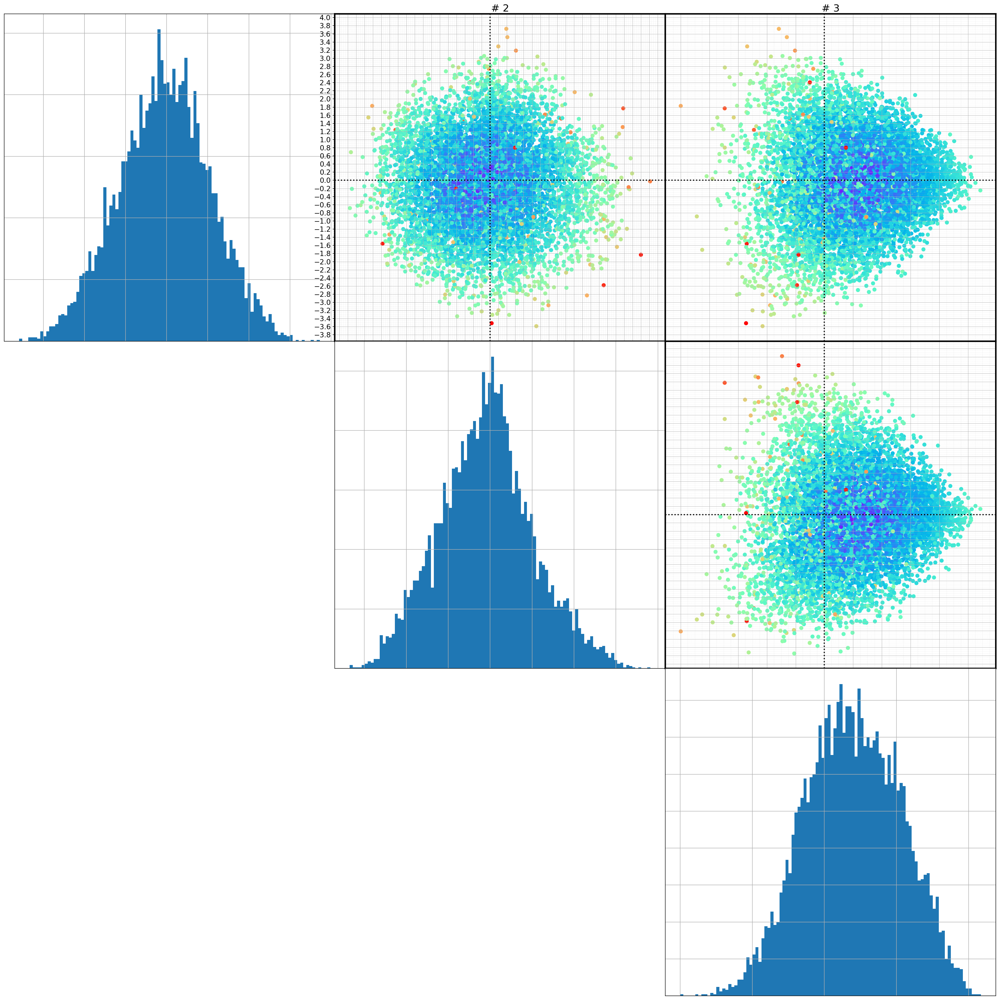

In [23]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=measure, figname=KEYWORD+'/latent_space_robust_covar')

In [24]:
measure_threshold=5

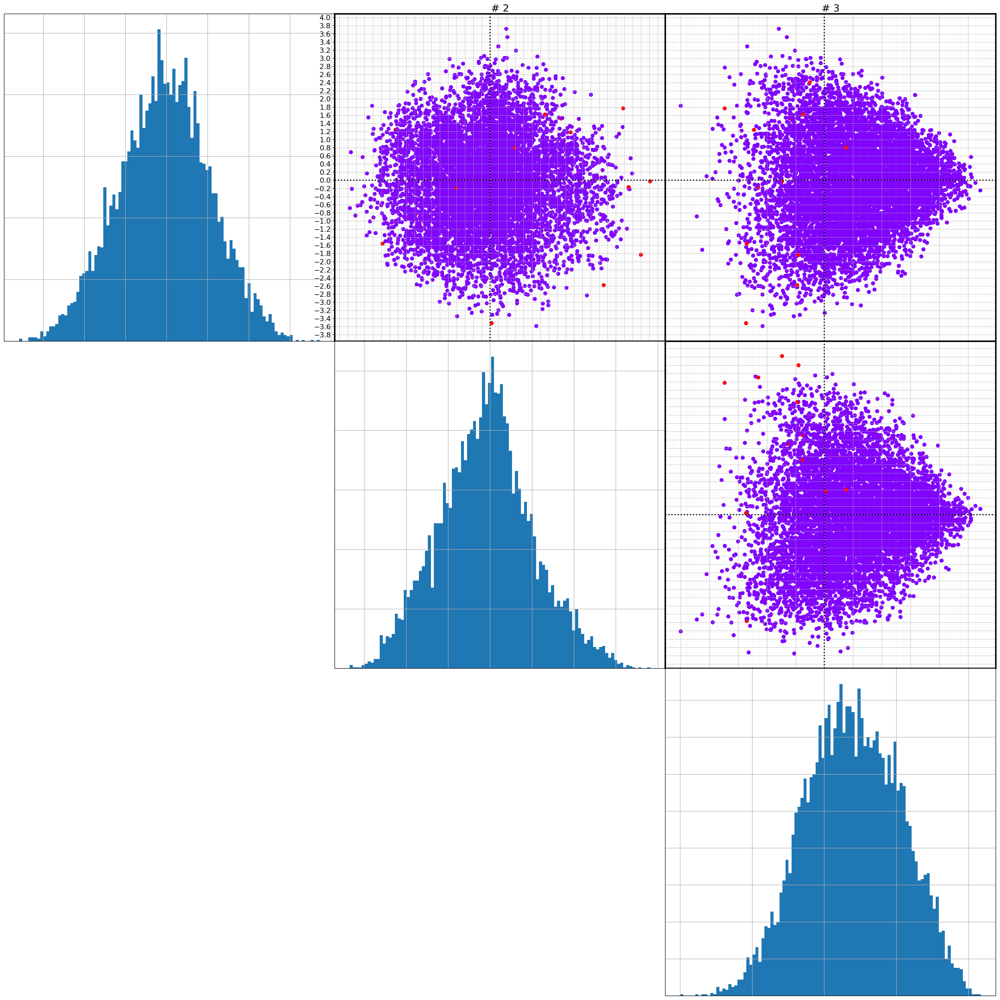

In [25]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=np.where(measure<measure_threshold,0,1), figname=KEYWORD+'/latent_space_robust_covar_assigned')

In [26]:
mus_kept = mus[np.where(measure<measure_threshold),:][0,...]
print(mus_kept.shape)
defocus_kept = np.array(metadata['_rlndefocusu'])[np.where(measure<measure_threshold)]
print(defocus_kept.shape)
angle_kept = np.array(metadata['_rlnanglepsi'])[np.where(measure<measure_threshold)]
print(angle_kept.shape)
Zscore_kept = np.array(metadata['_rlnparticleselectzscore'])[np.where(measure<measure_threshold)]
print(Zscore_kept.shape)

(8258, 4)
(8258,)
(8258,)
(8258,)


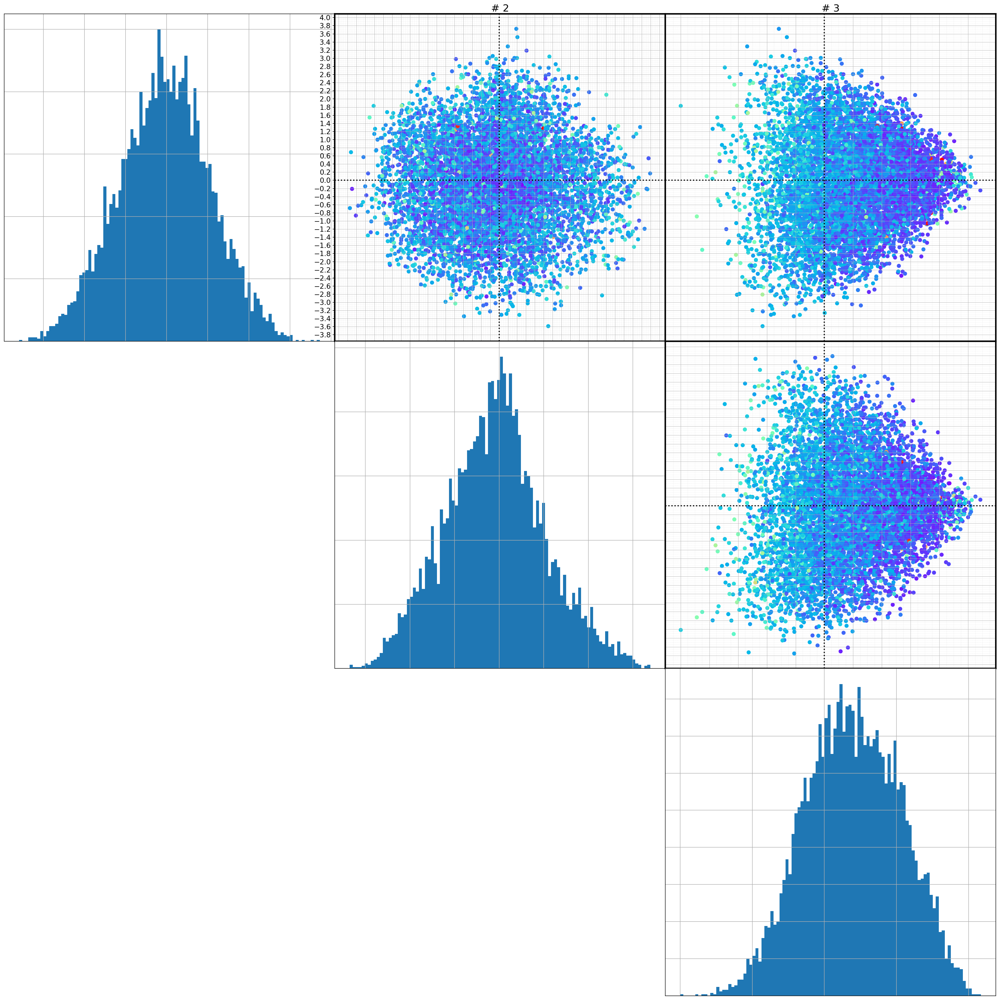

In [27]:
viz.biplots(mus_kept, n=3, show_histo=True, nbins=100, c=defocus_kept)

In [28]:
center = np.mean(mus_kept,axis=0) #np.zeros(mus_kept.shape) #
U, L, Vt = np.linalg.svd(mus_kept - center, full_matrices=False)

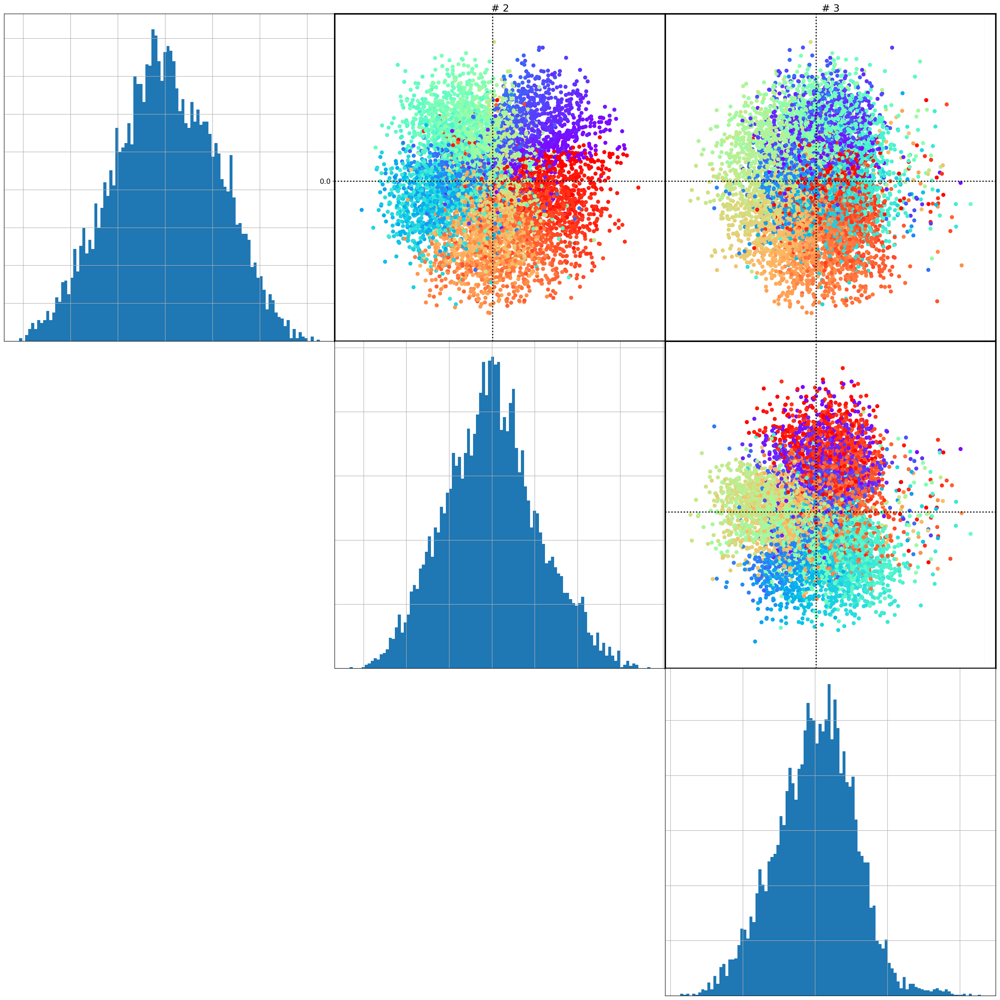

In [29]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=angle_kept)

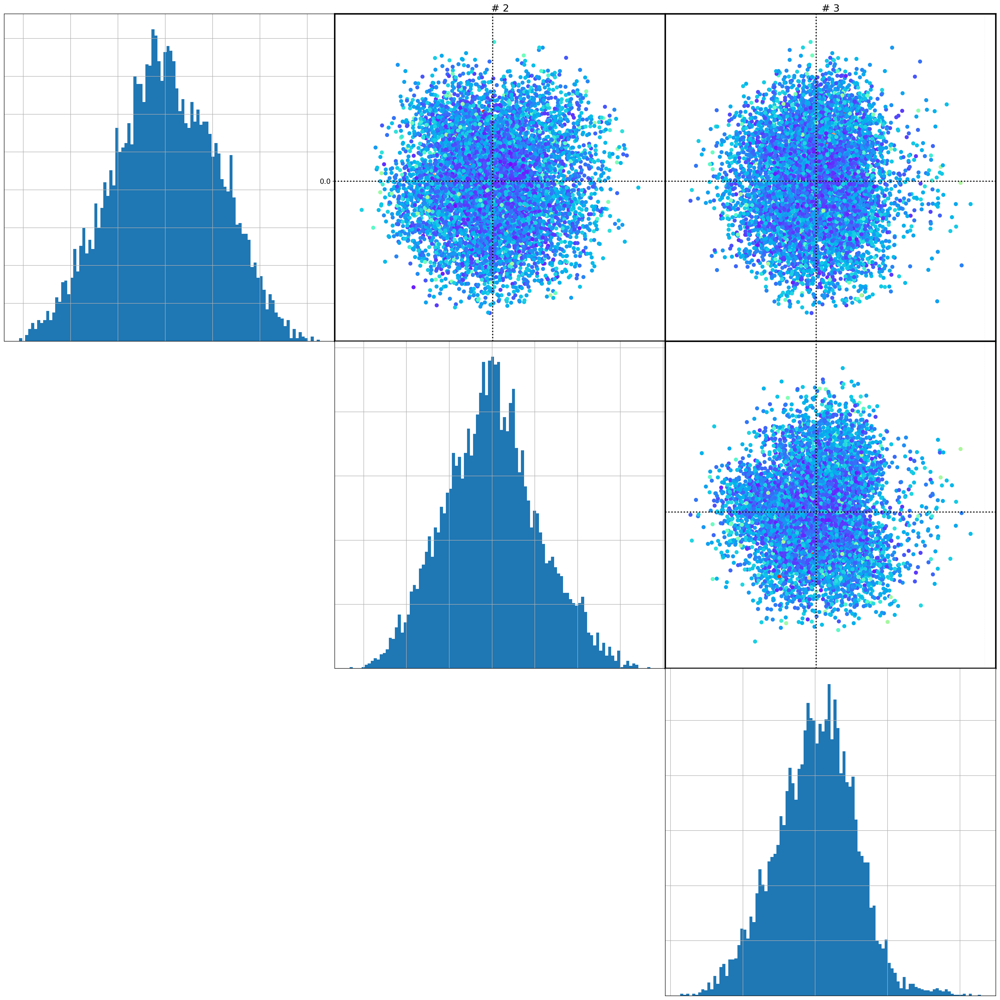

In [30]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=defocus_kept)

In [31]:
angle_true   = angle_kept + 180
defocus_true = defocus_kept

In [32]:
index = np.where((defocus_kept>5000)  & (defocus_kept < 25000))[0]

In [33]:
index.shape

(8034,)

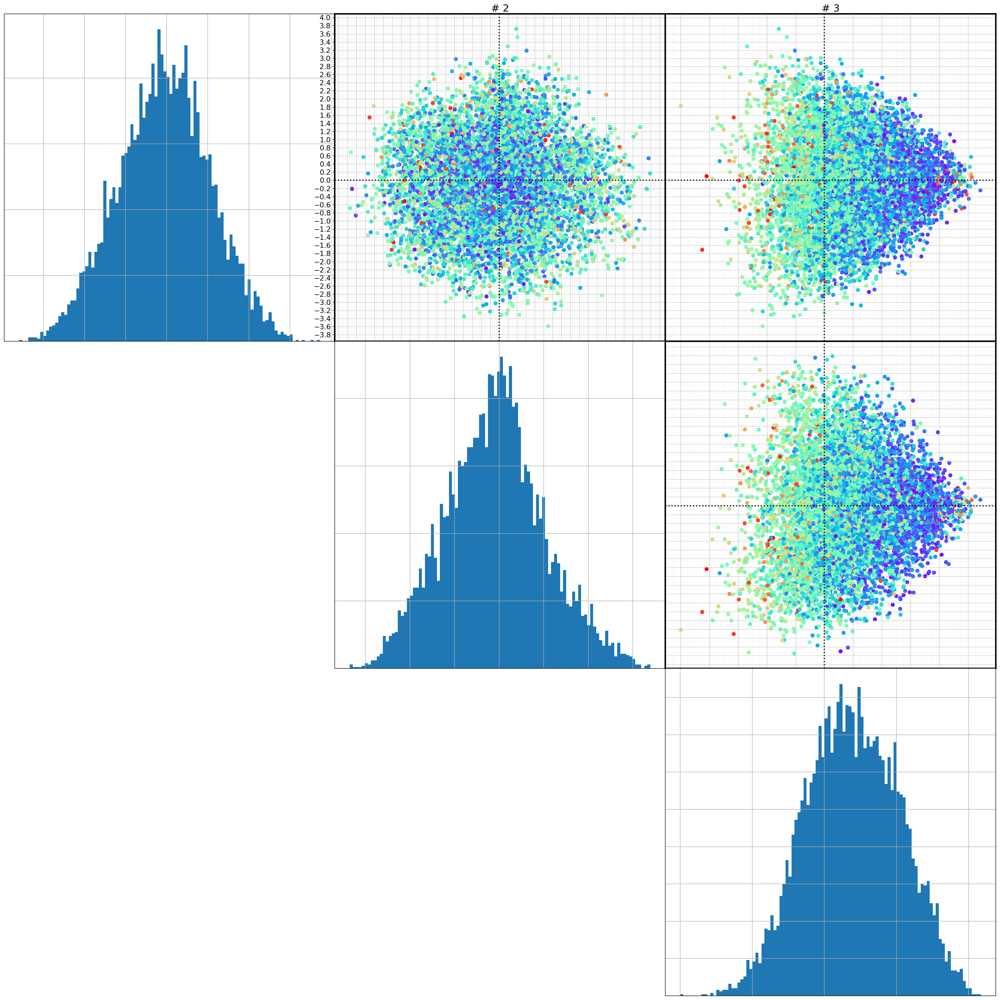

In [34]:
viz.biplots(mus_kept[index,:], n=3, show_histo=True, nbins=100, c=defocus_kept[index])

In [35]:
center = np.mean(mus_kept[index,:],axis=0) #np.zeros(mus_kept[index,:].shape) #
U_restricted, L_restricted, Vt_restricted = np.linalg.svd(mus_kept[index,:] - center, full_matrices=False)

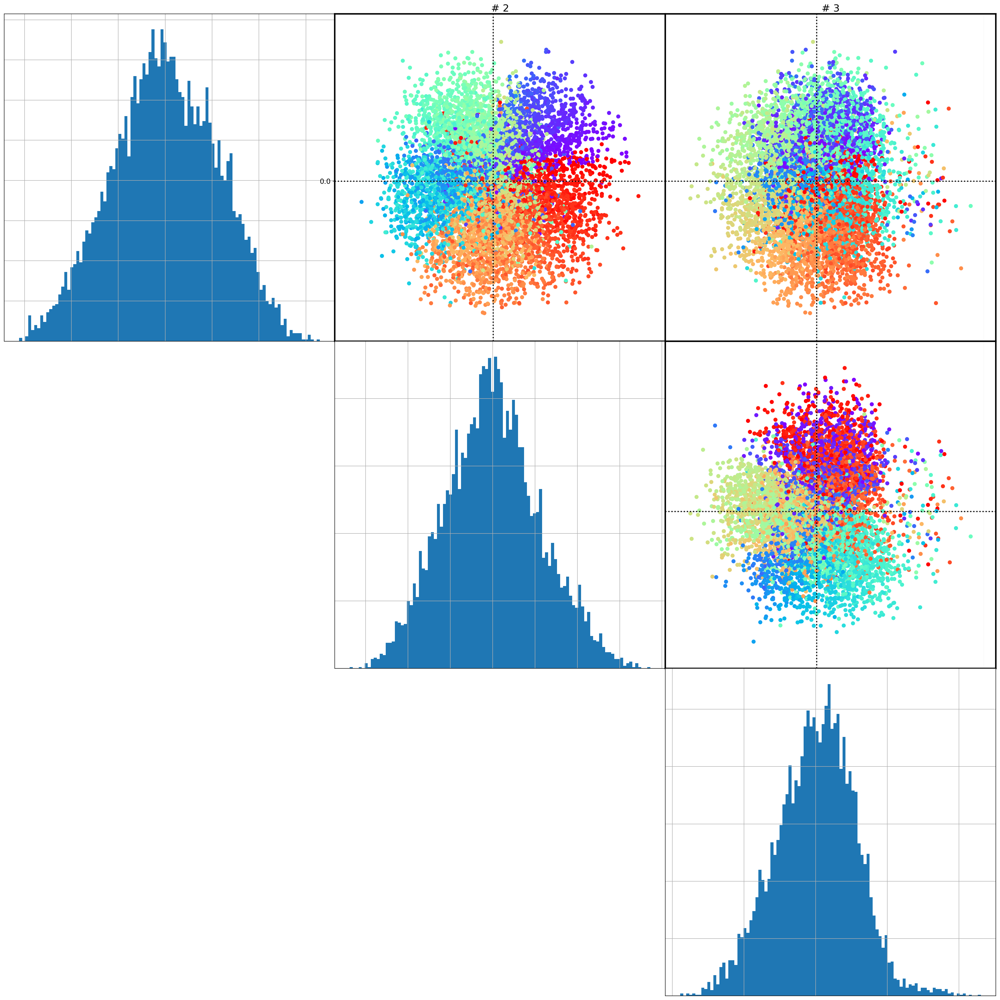

In [36]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=angle_kept[index])

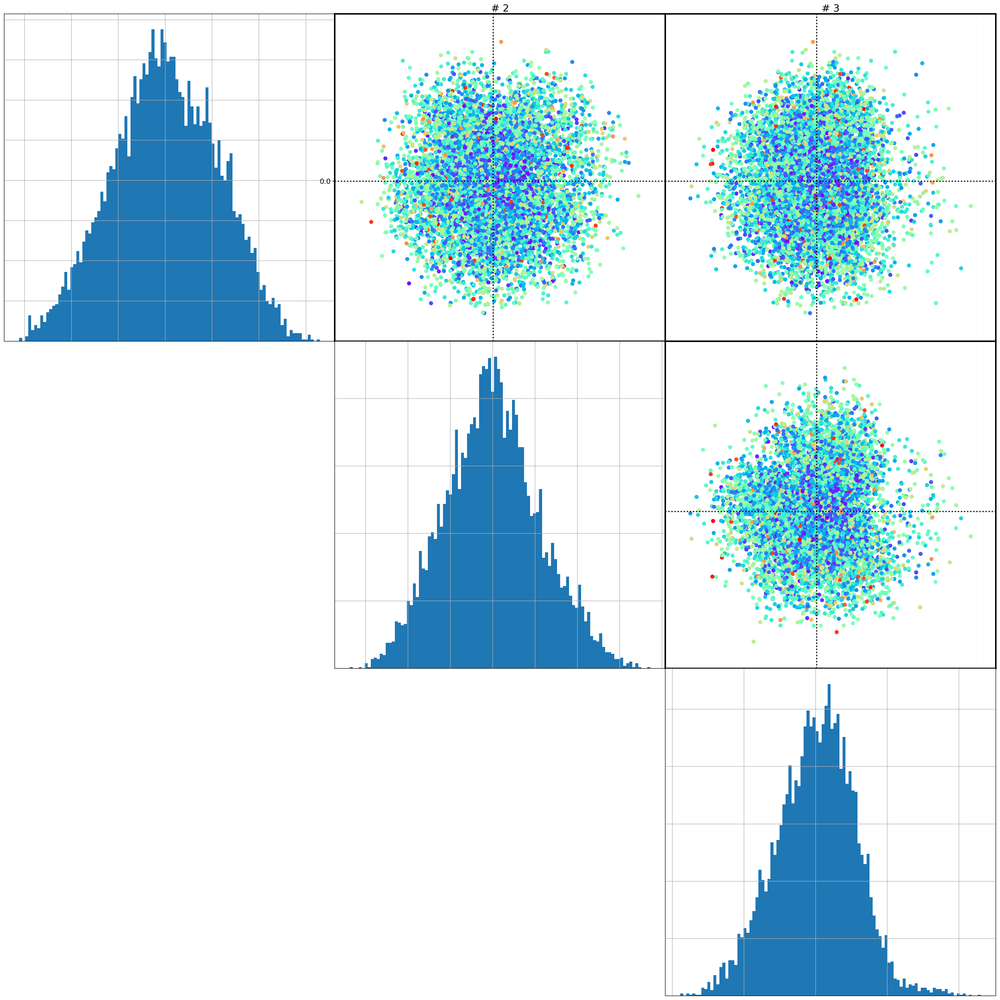

In [37]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=defocus_kept[index])

In [38]:
angle_restricted = angle_kept[index]
defocus_restricted = defocus_kept[index]

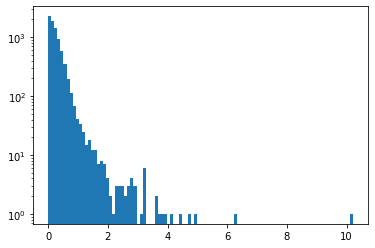

In [39]:
plt.hist(Zscore_kept[index], bins=100, log=True)
plt.show()

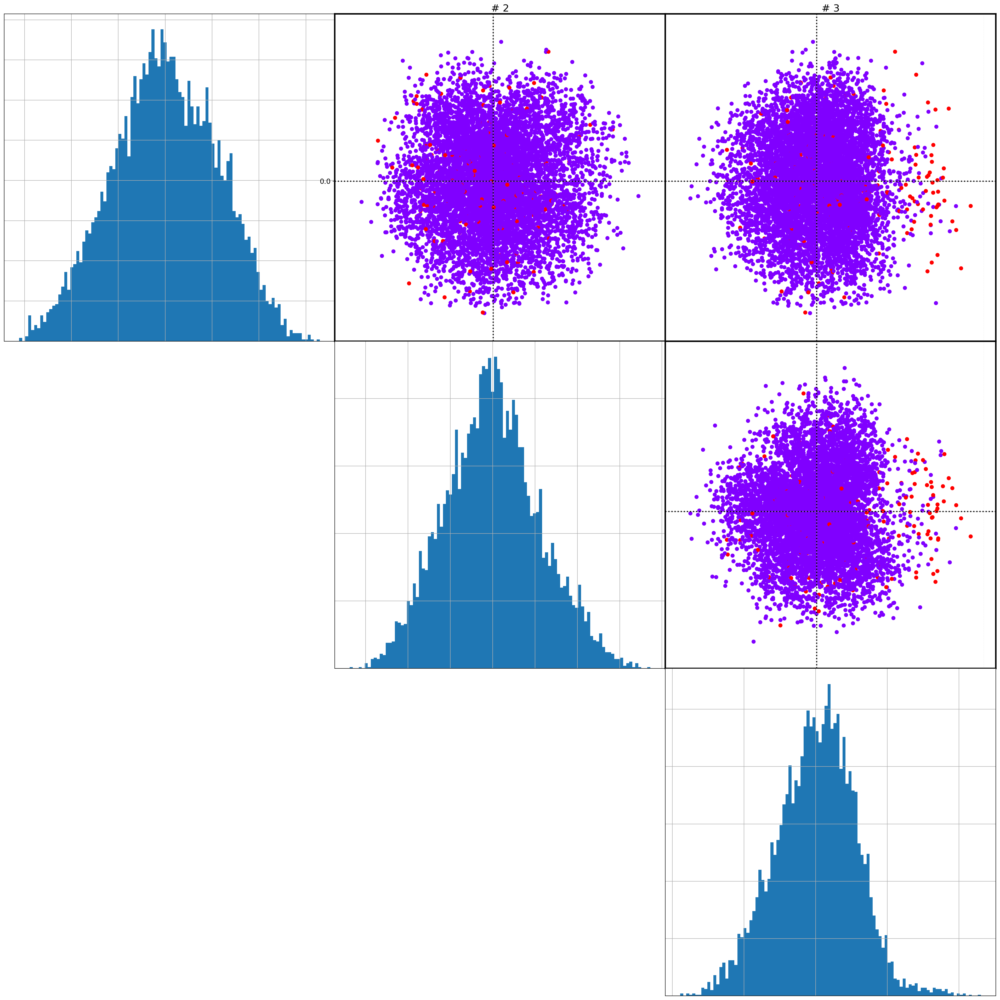

In [40]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=np.where(Zscore_kept[index]>1,1,0))

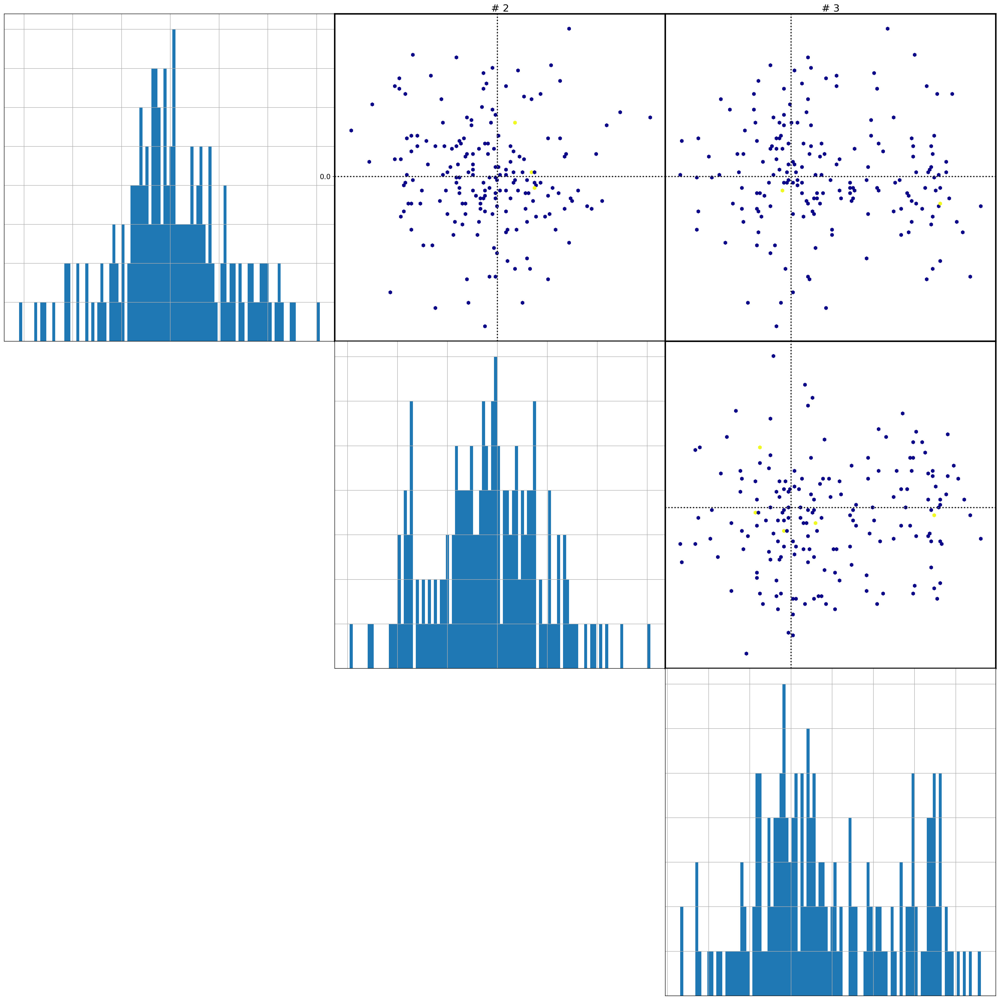

In [41]:
viz.biplots(U_restricted[np.where(Zscore_kept[index]>1)], n=3, show_histo=True, nbins=100)#, c=np.where(Zscore_kept[index]>1,1,0))

In [42]:
angle_pred, defocus_pred = pred.pred2d(U_restricted,  angle_true[index], defocus_true[index], 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

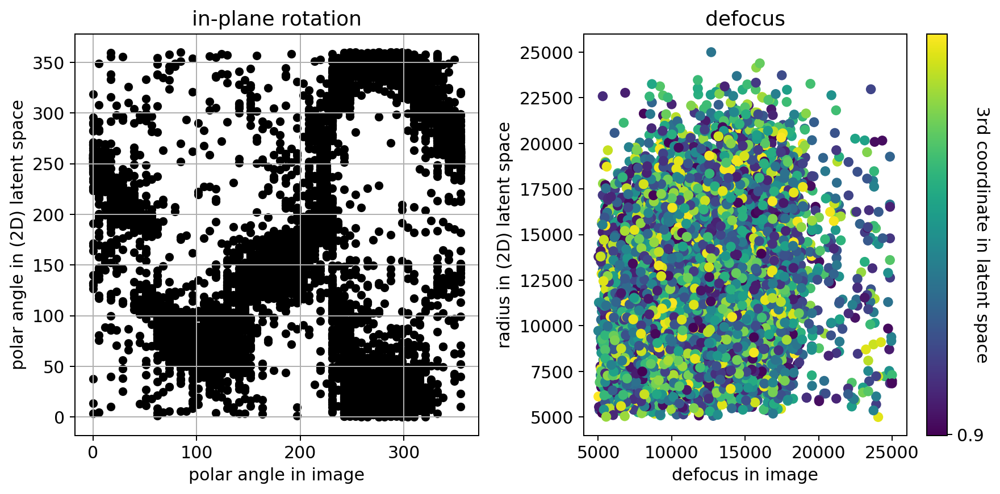

In [43]:
viz.plot_pred2d(angle_pred, defocus_pred, angle_true[index], defocus_true[index], metadata=angle_pred,
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

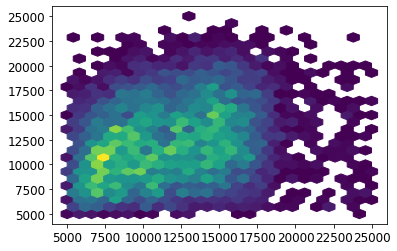

In [44]:
plt.hexbin(defocus_true[index],defocus_pred,gridsize=25,mincnt=1)

offset: -10.0 angle RMSE = 87.07425687473189
offset: -9.75 angle RMSE = 87.0724718936852
offset: -9.5 angle RMSE = 87.07097048844224
offset: -9.25 angle RMSE = 87.06961507916706
offset: -9.0 angle RMSE = 87.0682777478412
offset: -8.75 angle RMSE = 87.0672708650734
offset: -8.5 angle RMSE = 87.0665522503932
offset: -8.25 angle RMSE = 87.06598296697778
offset: -8.0 angle RMSE = 87.0657859222387
offset: -7.75 angle RMSE = 87.06590782288058
offset: -7.5 angle RMSE = 87.06628131028893
offset: -7.25 angle RMSE = 87.06698089956411
offset: -7.0 angle RMSE = 87.06809243847415
offset: -6.75 angle RMSE = 87.06923788240455
offset: -6.5 angle RMSE = 87.07049505256461
offset: -6.25 angle RMSE = 87.07216857559266
offset: -6.0 angle RMSE = 87.07362954913212
offset: -5.75 angle RMSE = 87.075030211202
offset: -5.5 angle RMSE = 87.07660293512747
offset: -5.25 angle RMSE = 87.07864308401791
defocus RMSE = 4835.7378390479935


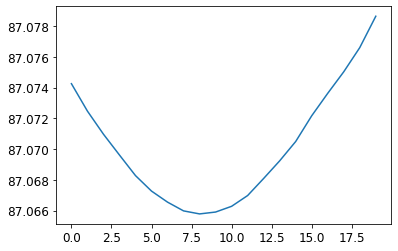

In [49]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(-10,-5,0.25))
plt.plot(angle_RMSE_list)

### weight angle RMSE with defocus pred

In [50]:
angle_pred, defocus_pred = pred.pred2d(U_restricted,  angle_true[index], defocus_true[index], 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

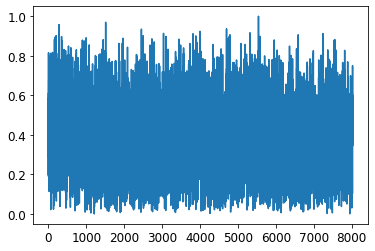

In [51]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)
plt.plot(defocus_pred_normalized)

offset: -94.0 angle RMSE = 74.08509679451224
offset: -93.75 angle RMSE = 74.08152534765456
offset: -93.5 angle RMSE = 74.07854514197525
offset: -93.25 angle RMSE = 74.07605652658702
offset: -93.0 angle RMSE = 74.07406435088727
offset: -92.75 angle RMSE = 74.07243400636979
offset: -92.5 angle RMSE = 74.07126667901552
offset: -92.25 angle RMSE = 74.0707871837742
offset: -92.0 angle RMSE = 74.07101554591857
offset: -91.75 angle RMSE = 74.07134130149208
offset: -91.5 angle RMSE = 74.07233448117896
offset: -91.25 angle RMSE = 74.07408910510891
offset: -91.0 angle RMSE = 74.07661848950633
offset: -90.75 angle RMSE = 74.07999147090369
offset: -90.5 angle RMSE = 74.08393437515336
offset: -90.25 angle RMSE = 74.08822420044459
defocus RMSE = 4835.7378390479935


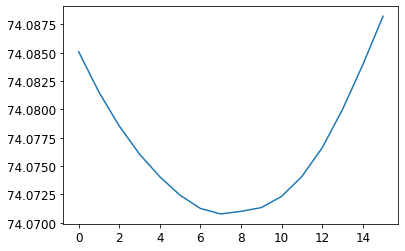

In [55]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(-94,-90,0.25),
                                                angle_weight=None, norm_weights=True)
plt.plot(angle_RMSE_list)

offset: -96.0 angle RMSE = 65.71548177410926
offset: -95.75 angle RMSE = 65.71209510177148
offset: -95.5 angle RMSE = 65.70935847533487
offset: -95.25 angle RMSE = 65.70723724345686
offset: -95.0 angle RMSE = 65.70598953314891
offset: -94.75 angle RMSE = 65.70556008859197
offset: -94.5 angle RMSE = 65.70572095143861
offset: -94.25 angle RMSE = 65.70668260700793
offset: -94.0 angle RMSE = 65.70857113054802
offset: -93.75 angle RMSE = 65.71130519834848
offset: -93.5 angle RMSE = 65.71486761720024
offset: -93.25 angle RMSE = 65.71917819892545
offset: -93.0 angle RMSE = 65.72426519332308
offset: -92.75 angle RMSE = 65.73009465164077
offset: -92.5 angle RMSE = 65.73669246313588
offset: -92.25 angle RMSE = 65.74419064595006
defocus RMSE = 4835.7378390479935


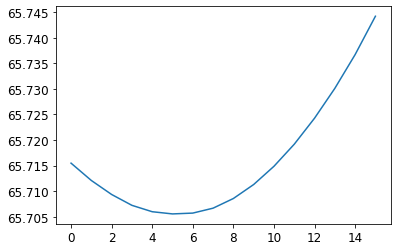

In [59]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(-96,-92,0.25),
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(angle_RMSE_list)

offset: -94.0 angle RMSE = 73.99652913640428
offset: -93.75 angle RMSE = 73.99181910800925
offset: -93.5 angle RMSE = 73.9877095541318
offset: -93.25 angle RMSE = 73.98406773965108
offset: -93.0 angle RMSE = 73.98090584454373
offset: -92.75 angle RMSE = 73.97807980277193
offset: -92.5 angle RMSE = 73.97568241736585
offset: -92.25 angle RMSE = 73.97399058746036
offset: -92.0 angle RMSE = 73.97303442860046
offset: -91.75 angle RMSE = 73.97214545531762
offset: -91.5 angle RMSE = 73.9719331307093
offset: -91.25 angle RMSE = 73.97246761242796
offset: -91.0 angle RMSE = 73.9737648196872
offset: -90.75 angle RMSE = 73.97590687319668
offset: -90.5 angle RMSE = 73.97858521752744
offset: -90.25 angle RMSE = 73.98158828264101
defocus RMSE = 4835.7378390479935


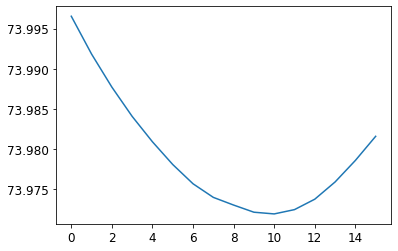

In [61]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(-94,-90,0.25),
                                                angle_weight=np.exp(-np.abs(Zscore[index])), norm_weights=True)
plt.plot(angle_RMSE_list)